<a href="https://colab.research.google.com/github/cedro3/few-shot-gan-adaptation/blob/gh-pages/few_shot.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## セットアップ

In [1]:
# github からコードを取得
! git clone https://github.com/cedro3/few-shot-gan-adaptation.git
%cd few-shot-gan-adaptation

# ライブラリーのインストール
! pip install torch==1.7.0+cu101 torchvision==0.8.1+cu101 -f https://download.pytorch.org/whl/torch_stable.html
! pip install pytorch-fid==0.1.1
! pip install visdom==0.1.8.9
! pip install lpips==0.1.3
! pip install scipy==1.1.0

# ninja システムのインストール
! wget https://github.com/ninja-build/ninja/releases/download/v1.8.2/ninja-linux.zip
! sudo unzip ninja-linux.zip -d /usr/local/bin/
! sudo update-alternatives --install /usr/bin/ninja ninja /usr/local/bin/ninja 1 --force

# 学習済みパラメータのダウンロード
import gdown
gdown.download('https://drive.google.com/u/0/uc?id=1TQ_6x74RPQf03mSjtqUijM4MZEMyn7HI', 'source_ffhq.pt', quiet=False)
gdown.download('https://drive.google.com/u/0/uc?id=1Qkdeyk_-1pqgvrIFy6AzsSYNgZMtwKX3', 'ffhq_sketches.pt', quiet=False)
gdown.download('https://drive.google.com/u/0/uc?id=1CX8uYEWqlZaY7or_iuLp3ZFBcsOOXMt8', 'ffhq_caricatures.pt', quiet=False)

# フォルダーの作成
import os
os.makedirs('traversals', exist_ok=True)

Cloning into 'few-shot-gan-adaptation'...
remote: Enumerating objects: 189, done.
remote: Counting objects: 100% (189/189), done.
remote: Compressing objects: 100% (156/156), done.
remote: Total 189 (delta 55), reused 137 (delta 31), pack-reused 0
Receiving objects: 100% (189/189), 66.44 MiB | 39.44 MiB/s, done.
Resolving deltas: 100% (55/55), done.
/content/few-shot-gan-adaptation
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 735.3MB 18kB/s 
     |████████████████████████████████| 12.7MB 34.5MB/s 
ERROR: torchtext 0.9.1 has requirement torch==1.8.1, but you'll have torch 1.7.0+cu101 which is incompatible.
  Found existing installation: torch 1.8.1+cu101
    Uninstalling torch-1.8.1+cu101:
      Successfully uninstalled torch-1.8.1+cu101
  Found existing installation: torchvision 0.9.1+cu101
    Uninstalling torchvision-0.9.1+cu101:
      Successfully uninstalled torchvision-0.9.1+cu101
  Created wheel for pytorch-fid: file

Downloading...
From: https://drive.google.com/u/0/uc?id=1TQ_6x74RPQf03mSjtqUijM4MZEMyn7HI
To: /content/few-shot-gan-adaptation/source_ffhq.pt
827MB [00:07, 113MB/s] 
Downloading...
From: https://drive.google.com/u/0/uc?id=1Qkdeyk_-1pqgvrIFy6AzsSYNgZMtwKX3
To: /content/few-shot-gan-adaptation/ffhq_sketches.pt
121MB [00:00, 124MB/s]
Downloading...
From: https://drive.google.com/u/0/uc?id=1CX8uYEWqlZaY7or_iuLp3ZFBcsOOXMt8
To: /content/few-shot-gan-adaptation/ffhq_caricatures.pt
121MB [00:01, 105MB/s] 


## FFHQ & Sketches（noise.pt）

**Sketches から noise.pt で画像生成**

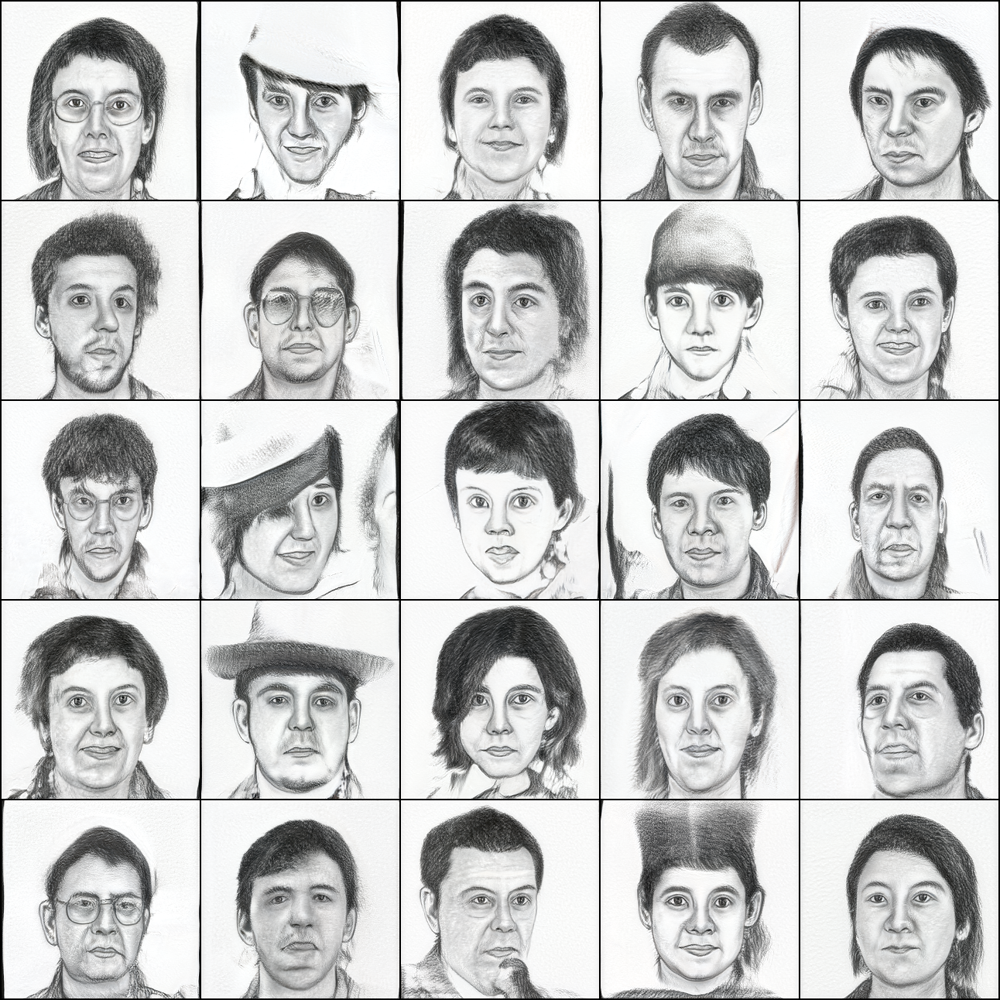

In [2]:
# Targetから画像生成
! python generate_img.py --ckpt_target ffhq_sketches.pt --load_noise noise.pt

from IPython.display import Image, display_png
display_png(Image('./test_sample/sample.png'))

**FFHQ & Sketches を noise.pt で視覚化**

In [3]:
# source & target の画像補完
! python generate_img.py --ckpt_source source_ffhq.pt --ckpt_target ffhq_sketches.pt\
                           --mode interpolate --load_noise noise.pt

# output.mp4 ファイル削除
if os.path.exists('./output.mp4'):
   os.remove('./output.mp4')

# traversals フォルダーの静止画から動画を作成
! ffmpeg -r 15 -i traversals/sample%3d.png\
               -vcodec libx264 -pix_fmt yuv420p output.mp4

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [4]:
# 動画再生
from IPython.display import HTML
from base64 import b64encode

mp4 = open('./output.mp4', 'rb').read()
data_url = 'data:video/mp4;base64,' + b64encode(mp4).decode()
HTML(f"""
<video width="50%" height="50%" controls>
      <source src="{data_url}" type="video/mp4">
</video>""")

## FFHQ & Caricatures（noise.pt）

**Caricatures から noise.pt で画像生成**

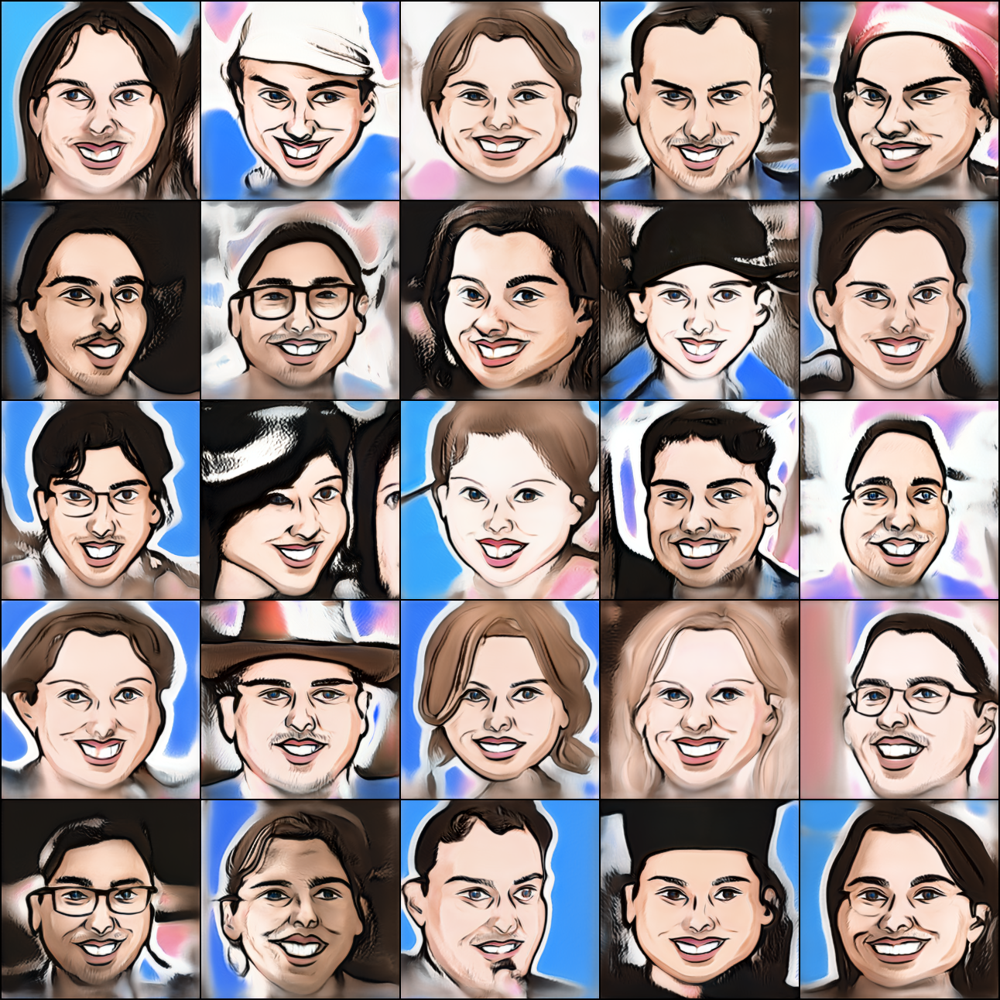

In [5]:
# GANからの画像生成（noise.pt）
! python generate_img.py --ckpt_target ffhq_caricatures.pt --load_noise noise.pt

from IPython.display import Image, display_png
display_png(Image('./test_sample/sample.png'))

**FFHQ & Caricatures を noise.pt で視覚化**

In [6]:
# source & target の画像補完
! python generate_img.py --ckpt_source source_ffhq.pt --ckpt_target ffhq_caricatures.pt\
                           --mode interpolate --load_noise noise.pt

# output.mp4 ファイル削除
if os.path.exists('./output.mp4'):
   os.remove('./output.mp4')

# traversals フォルダーの静止画から動画を作成
! ffmpeg -r 15 -i traversals/sample%3d.png\
               -vcodec libx264 -pix_fmt yuv420p output.mp4

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [7]:
# 動画再生
from IPython.display import HTML
from base64 import b64encode

mp4 = open('./output.mp4', 'rb').read()
data_url = 'data:video/mp4;base64,' + b64encode(mp4).decode()
HTML(f"""
<video width="50%" height="50%" controls>
      <source src="{data_url}" type="video/mp4">
</video>""")

##FFHQ & Sketches（random.seed）

**Sketches から random.seed で画像生成**

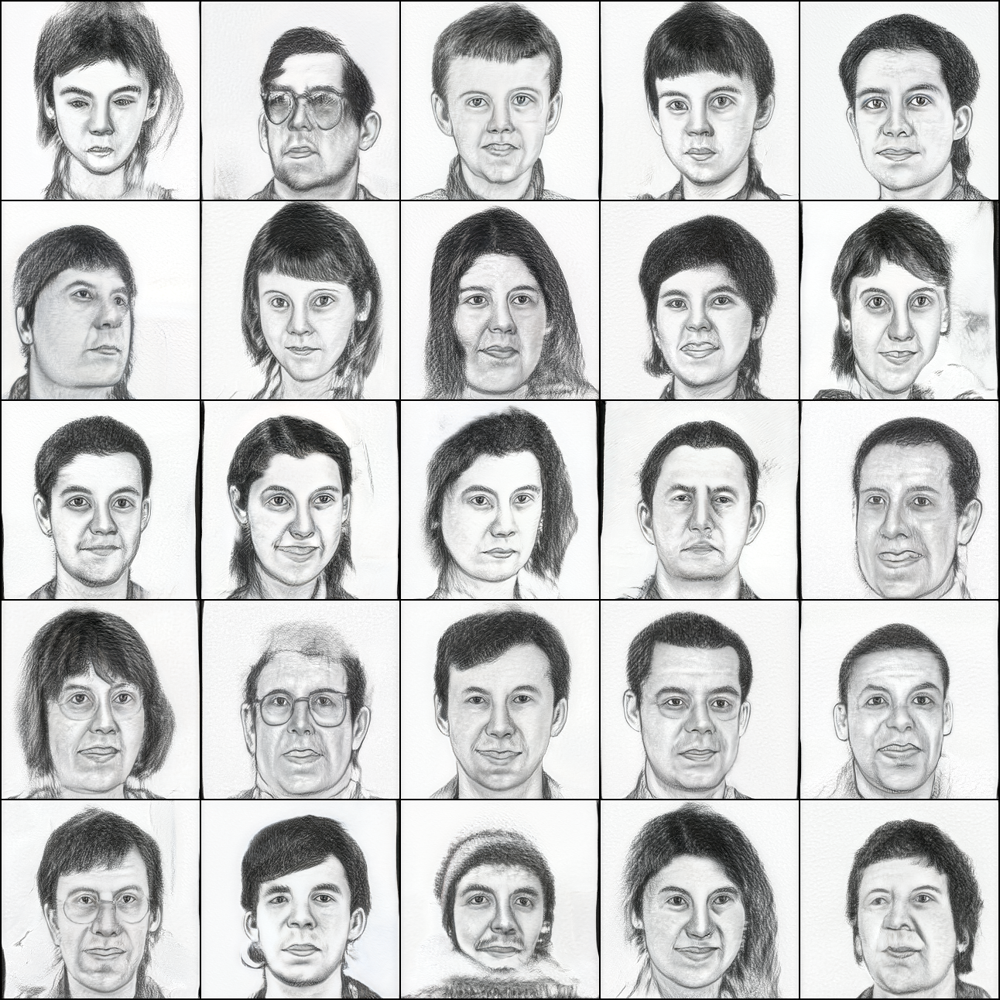

In [8]:
# Targetから画像生成
! python generate_img.py --ckpt_target ffhq_sketches.pt --rand 3

from IPython.display import Image, display_png
display_png(Image('./test_sample/sample.png'))

**FFHQ & Sketches を random.seed で視覚化**

In [9]:
# source & target の画像補完
! python generate_img.py --ckpt_source source_ffhq.pt --ckpt_target ffhq_sketches.pt\
                           --mode interpolate --rand 3

# output.mp4 ファイル削除
if os.path.exists('./output.mp4'):
   os.remove('./output.mp4')

# traversals フォルダーの静止画から動画を作成
! ffmpeg -r 15 -i traversals/sample%3d.png\
               -vcodec libx264 -pix_fmt yuv420p output.mp4

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [10]:
# 動画再生
from IPython.display import HTML
from base64 import b64encode

mp4 = open('./output.mp4', 'rb').read()
data_url = 'data:video/mp4;base64,' + b64encode(mp4).decode()
HTML(f"""
<video width="50%" height="50%" controls>
      <source src="{data_url}" type="video/mp4">
</video>""")

##FFHQ & Caricatures（random.seed）

**Caricatures から random.seed で画像生成**

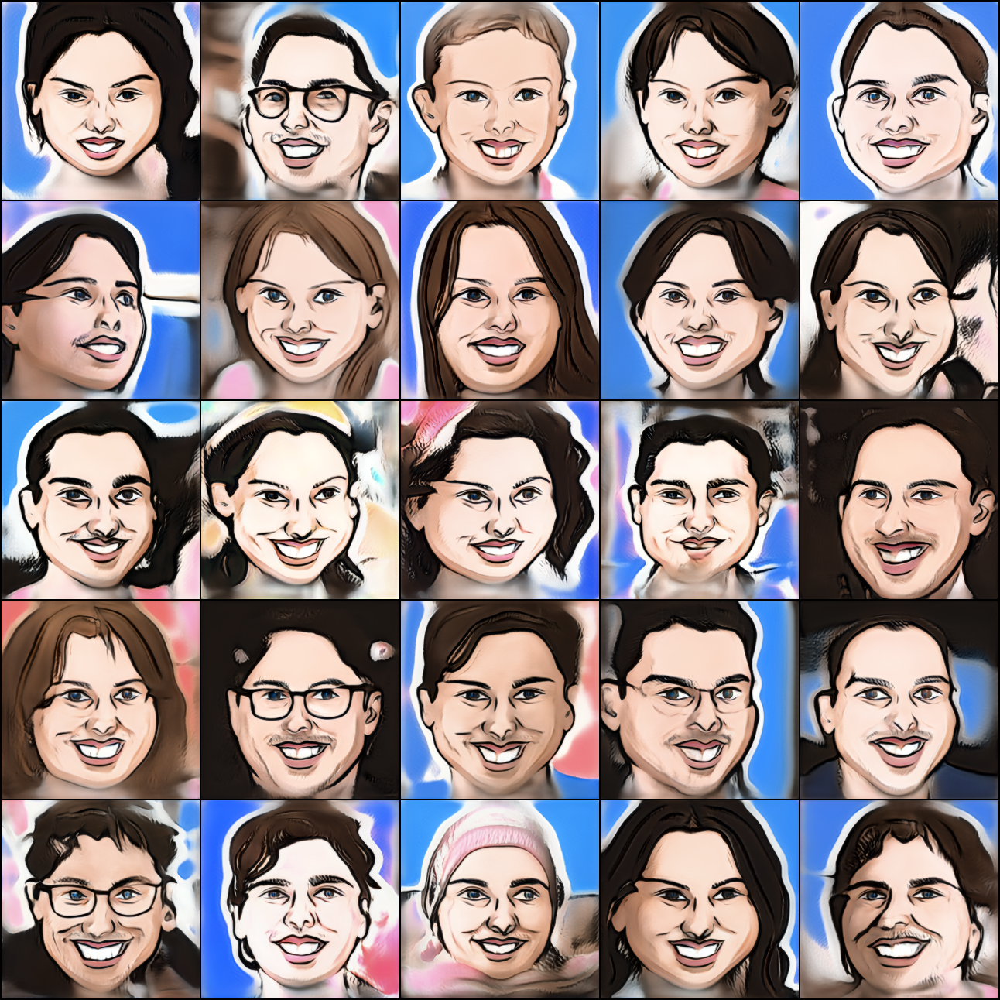

In [11]:
# Targetから画像生成
! python generate_img.py --ckpt_target ffhq_caricatures.pt --rand 3

from IPython.display import Image, display_png
display_png(Image('./test_sample/sample.png'))

**FFHQ & Caricatures を random.seed で視覚化**

In [12]:
# source & target の画像補完
! python generate_img.py --ckpt_source source_ffhq.pt --ckpt_target ffhq_caricatures.pt\
                           --mode interpolate --rand 3

# output.mp4 ファイル削除
if os.path.exists('./output.mp4'):
   os.remove('./output.mp4')

# traversals フォルダーの静止画から動画を作成
! ffmpeg -r 15 -i traversals/sample%3d.png\
               -vcodec libx264 -pix_fmt yuv420p output.mp4

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [13]:
# 動画再生
from IPython.display import HTML
from base64 import b64encode

mp4 = open('./output.mp4', 'rb').read()
data_url = 'data:video/mp4;base64,' + b64encode(mp4).decode()
HTML(f"""
<video width="50%" height="50%" controls>
      <source src="{data_url}" type="video/mp4">
</video>""")